# STOCK MARKET ANALYSIS AND PREDICTIONS FOR THREE TECH COMPANIES (AMAZON, APPLE, AND MICROSOFT)

## INTRODUCTION

The Kaggle dataset provided focuses on the S&P 500 companies historical prices for fundamental and technical analysis.

Dataset consists of the following files:

- **prices.csv:** raw, as-is daily prices. Most of data spans from 2010 to the end 2016, for companies new on stock market date range is shorter. There have been approx. 140 stock splits in that time, this set doesn't account for that.
- **prices-split-adjusted.csv:** same as prices, but there have been added adjustments for splits.
- **securities.csv:** general description of each company with division on sectors
- **fundamentals.csv:** metrics extracted from annual SEC 10K fillings (2012-2016), should be enough to derive most of popular fundamental indicators.

For this project, we used the **prices-split-adjusted.csv** to analyse and make prediction of stock closing prices of three tech companies (Amazon, Apple, Microsoft). 

## DATA WRANGLING

In [1]:
# import required libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from pandas.plotting import scatter_matrix
from datetime import datetime
%matplotlib inline

# ignore future warnings
import warnings
warnings.filterwarnings("ignore")

# setting visualization parameters
sns.set()
sns.set_style('dark')
plt.rcParams['font.size'] = 20
plt.rcParams['figure.figsize'] = (22, 8)
plt.rcParams['figure.facecolor'] = '#00000000'
plt.rcParams['lines.linewidth'] = 2

In [2]:
# load data
df = pd.read_csv("prices-split-adjusted.csv", parse_dates=['date'])
df

,date,symbol,open,close,low,high,volume
0,2016-01-05,WLTW,123.430000,125.839996,122.309998,126.250000,2163600.0
1,2016-01-06,WLTW,125.239998,119.980003,119.940002,125.540001,2386400.0
2,2016-01-07,WLTW,116.379997,114.949997,114.930000,119.739998,2489500.0
3,2016-01-08,WLTW,115.480003,116.620003,113.500000,117.440002,2006300.0
4,2016-01-11,WLTW,117.010002,114.970001,114.089996,117.330002,1408600.0
...,...,...,...,...,...,...,...
851259,2016-12-30,ZBH,103.309998,103.199997,102.849998,103.930000,973800.0
851260,2016-12-30,ZION,43.070000,43.040001,42.689999,43.310001,1938100.0
851261,2016-12-30,ZTS,53.639999,53.529999,53.270000,53.740002,1701200.0
851262,2016-12-30,AIV,44.730000,45.450001,44.410000,45.590000,1380900.0


In [3]:
# check data info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 851264 entries, 0 to 851263
Data columns (total 7 columns):
 #   Column  Non-Null Count   Dtype         
---  ------  --------------   -----         
 0   date    851264 non-null  datetime64[ns]
 1   symbol  851264 non-null  object        
 2   open    851264 non-null  float64       
 3   close   851264 non-null  float64       
 4   low     851264 non-null  float64       
 5   high    851264 non-null  float64       
 6   volume  851264 non-null  float64       
dtypes: datetime64[ns](1), float64(5), object(1)
memory usage: 45.5+ MB


In [4]:
# check missing values
df.isnull().sum()

date      0
symbol    0
open      0
close     0
low       0
high      0
volume    0
dtype: int64

In [5]:
# check for duplicates
df.duplicated().sum()

0

In [6]:
# Bringing out the companies to work on

amazon = df[df["symbol"]=="AMZN"]
apple= df[df['symbol']=="AAPL"]
microsoft = df[df["symbol"]=="MSFT"]

**These three were chosen based on there trading volumes in Information and Technology Sector.**

## EXPLORATORY DATA ANALYSIS

### Amazon Stock Analysis

In [7]:
# check amazon dataframe header
amazon.head()

,date,symbol,open,close,low,high,volume
284,2010-01-04,AMZN,136.250000,133.899994,133.139999,136.610001,7599900.0
751,2010-01-05,AMZN,133.429993,134.690002,131.809998,135.479996,8851900.0
1219,2010-01-06,AMZN,134.600006,132.250000,131.649994,134.729996,7178800.0
1687,2010-01-07,AMZN,132.009995,130.000000,128.800003,132.320007,11030200.0
2155,2010-01-08,AMZN,130.559998,133.520004,129.029999,133.679993,9830500.0


In [8]:
# visualize trends of open and close price
fig = px.line(
    amazon, 
    x="date", 
    y=["open", 'close'], 
    title="Differences between open and close prices of Amazon" 
)
fig.update_xaxes(rangeslider_visible=True)
fig.show()

***The chart above is the plot of open and close prices against time. The chart shows an upward trend movement of price from 2011 to 2016. There is a significant downward reversal between december 2015 and Feb 2016.***

In [9]:
# visualize trends of high and low price
fig = px.line(
    amazon, 
    x="date",
    y=["high", "low"], 
    title="Differences between high and low prices of Amazon"
)
fig.update_xaxes(rangeslider_visible=True)
fig.show()

**Just like the open and close prices, the high and low prices have an upward trend from mid 2010 to 2017**

In [10]:
# visualize trends in the volume traded
fig = px.line(amazon, x="date", y="volume", title="Volume Traded by Amazon")
fig.show()

**Trading Volume determines Liquidity and Market Strenght, Exhaustion move etc.**

In [11]:
# check the maximum volume traded
amazon['volume'].argmax()

139

In [12]:
# locate the date of the max volume
amazon.iloc[amazon['volume'].argmax()]

date      2010-07-23 00:00:00
symbol                   AMZN
open                   105.93
close              118.870003
low                105.800003
high               119.279999
volume             42421100.0
Name: 65395, dtype: object

**There is an unusual spike in the volume of Amazon on the 23rd of July, 2010.**

### Bolinger Band for Amazon

**Bollinger bands are use to determine overbought and oversold. its indicator focuses on price and volatility.**

   Bolinger Band = MA +/- 2*std

#### Defining Terms:

MA = Moving Average

std = Standard Deviation

TP = Target Price

Bolinger Band = MA +/- 2*std .

BOLU = bolinger upper part = MA + 2*std

BOLD = bolinger lower part = MA - 2*std

In [13]:
# create required column
amazon['TP'] = (df["close"] +df["low"] + df["high"])/3
amazon['std'] = amazon['TP'].rolling(20).std(ddof=0)
amazon["MA-TP"] = amazon["TP"].rolling(20).mean()
amazon["BOLU"] = amazon["MA-TP"]+2*amazon["std"]
amazon['BOLD'] = amazon["MA-TP"] - 2*amazon['std']

In [14]:
# assess dataframe
amazon

,date,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD
284,2010-01-04,AMZN,136.250000,133.899994,133.139999,136.610001,7599900.0,134.549998,NaN,NaN,NaN,NaN
751,2010-01-05,AMZN,133.429993,134.690002,131.809998,135.479996,8851900.0,133.993332,NaN,NaN,NaN,NaN
1219,2010-01-06,AMZN,134.600006,132.250000,131.649994,134.729996,7178800.0,132.876663,NaN,NaN,NaN,NaN
1687,2010-01-07,AMZN,132.009995,130.000000,128.800003,132.320007,11030200.0,130.373337,NaN,NaN,NaN,NaN
2155,2010-01-08,AMZN,130.559998,133.520004,129.029999,133.679993,9830500.0,132.076665,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
848799,2016-12-23,AMZN,764.549988,760.590027,757.989990,766.500000,1976900.0,761.693339,8.065244,762.891169,779.021657,746.760682
849299,2016-12-27,AMZN,763.400024,771.400024,761.200012,774.650024,2627400.0,769.083353,8.055304,762.878503,778.989112,746.767894
849799,2016-12-28,AMZN,776.250000,772.130005,770.500000,780.000000,3279100.0,774.210002,8.422107,763.360169,780.204383,746.515956
850299,2016-12-29,AMZN,772.400024,765.150024,760.849976,773.400024,3153500.0,766.466675,8.286509,763.868336,780.441353,747.295319


In [15]:
# check number of missing values
amazon.isnull().sum()

date       0
symbol     0
open       0
close      0
low        0
high       0
volume     0
TP         0
std       19
MA-TP     19
BOLU      19
BOLD      19
dtype: int64

**The Std, BOLD, BOLU and MA_TP all have 19 Null value because of the 20 moving average**

In [16]:
# set date column as index
amazon = amazon.set_index("date")

<Figure size 1440x1440 with 0 Axes>

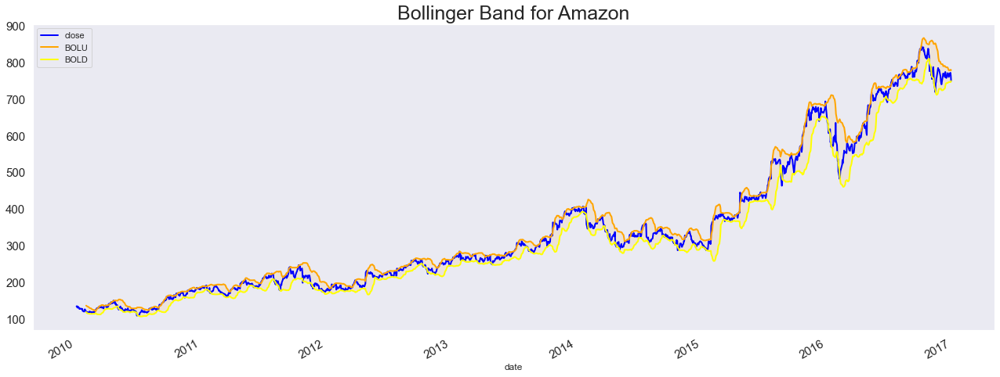

In [17]:
plt.figure(figsize=(20,20))
ax=amazon[["close", "BOLU", 'BOLD']].plot(color=['blue', 'orange', 'yellow'], fontsize = 15)
ax.fill_between(amazon.index, amazon["BOLD"], amazon["BOLU"], facecolor='orange', alpha=0.1)
plt.title("Bollinger Band for Amazon", fontsize = 25)
plt.show()

***The Bolinger Band can be used to determine the volatility of an asset as well as identifying the trend using overbought and oversold strategy. The tightness of the Bollinger band shows that the asset is less volatile because the tightness of Bollinger is inversely proportional to Volatility.***

In [18]:
# create new dataframe for dates from 2016-01-01
amazon_new = amazon[amazon.index >= datetime(2016,1,1)]
amazon_new.head()

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD
date,,,,,,,,,,,
2016-01-04,AMZN,656.289978,636.989990,627.510010,657.719971,9314500.0,640.739990,11.928722,666.938170,690.795615,643.080726
2016-01-05,AMZN,646.859985,633.789978,627.650024,646.909973,5822600.0,636.116658,13.661357,665.263669,692.586384,637.940954
2016-01-06,AMZN,622.000000,632.650024,620.309998,639.789978,5329200.0,630.916667,15.540708,663.379668,694.461084,632.298252
2016-01-07,AMZN,621.799988,607.940002,605.210022,630.000000,7074900.0,614.383341,18.684169,660.480336,697.848674,623.111997
2016-01-08,AMZN,619.659973,607.049988,606.000000,624.140015,5512900.0,612.396668,21.344299,657.775669,700.464268,615.087070


<Figure size 1440x1440 with 0 Axes>

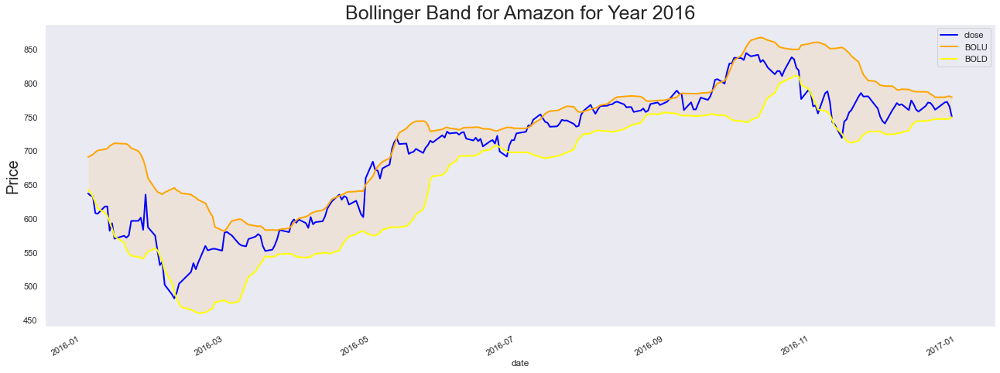

In [19]:
# better visualization of trend
plt.figure(figsize=(20,20))
ax=amazon_new[["close", "BOLU", 'BOLD']].plot(color=['blue', 'orange', 'yellow'])
ax.fill_between(amazon_new.index, amazon_new["BOLD"], amazon_new["BOLU"], facecolor='orange', alpha=0.1)
plt.title("Bollinger Band for Amazon for Year 2016", fontsize = 25)
plt.ylabel("Price", fontsize = 20)
plt.show()

### Insight

**Amazon has a very tight Bollinger which shows that the market was less volatile i.e stable market. The Chart above shows the bollinger band of amazon for the year 2016. The has a better visual so as to be able to visualize the point of bounce and pullback. The price of asset breaking below the lower band around late of 2016-02 indicates oversold which was responsible for the bounce. On the other hand a point, a point arround may shows a pullback when the price crosses the upper band.**

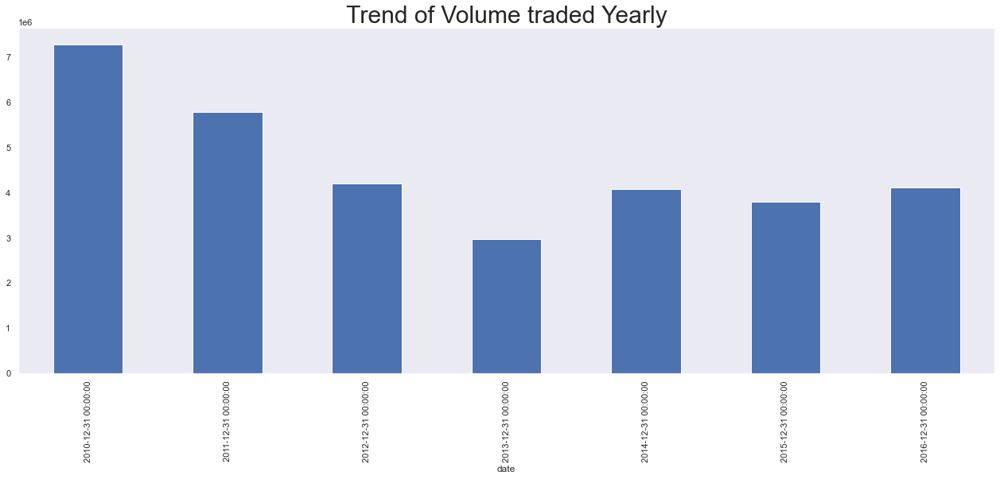

In [20]:
# visualize volume traded resampled yearly  
amazon['volume'].resample("Y").mean().plot.bar()
plt.title('Trend of Volume traded Yearly', fontsize=30);

### Insight:

**As Volume is viewed as an indicator of liquidity, the downward trend of traded volume over the course of years shows that the ease of converting the asset into ready cash without affecting its market price is reducing.**

Don't forget we had an upward trend in price. So, upward trend in price while there is downward trend in volume indicates that the investors are choosing to invest at the current pricing level.

### Apple Stock Analysis

In [21]:
# check apple dataframe header
apple.head(5)

,date,symbol,open,close,low,high,volume
254,2010-01-04,AAPL,30.490000,30.572857,30.340000,30.642857,123432400.0
721,2010-01-05,AAPL,30.657143,30.625713,30.464285,30.798571,150476200.0
1189,2010-01-06,AAPL,30.625713,30.138571,30.107143,30.747143,138040000.0
1657,2010-01-07,AAPL,30.250000,30.082857,29.864286,30.285715,119282800.0
2125,2010-01-08,AAPL,30.042856,30.282858,29.865715,30.285715,111902700.0


In [22]:
# visualize trends of open, close, high and low price
fig= px.line(
    apple, 
    x="date", 
    y=["open", 'high', 'low', 'close'], 
    title="Apple Stock Prices "
)
fig.show("notebook")

**On overrall over the years, the chart shows an upward trend in the movement of price. Although bthe movement is not perfect as there was an aggressive downward trend from September 2012 to April 2013. Also it can be deduced that the market made an unusual low arround August, 2015 considering the movement of Price before then and since then, the market has been on consolidation.**

In [23]:
# visualize trends in the volume traded
fig = px.line(
    apple, 
    x="date", 
    y="volume",
    title= "Apple Trading Apple Volume"
)
fig.show("notebook")

In [24]:
# check the minimum volume traded
apple['volume'].argmin()

1737

In [25]:
# locate the date of the min volume
apple.iloc[apple['volume'].argmin()]

date      2016-11-25 00:00:00
symbol                   AAPL
open               111.129997
close              111.790001
low                110.949997
high               111.870003
volume             11475900.0
Name: 838767, dtype: object

**Apple has it lowest volume at December 25, 2016.**

# Bollinger Band for apple

In [26]:
# set date column as index
apple = apple.set_index("date")

In [27]:
# creating required column
apple["TP"] = (apple["close"] + apple['high'] + apple ["low"])/3
apple['std'] = apple['TP'].rolling(20).std(ddof=0)
apple["MA-TP"] = apple["TP"].rolling(20).mean()
apple["BOLU"]= apple["MA-TP"] + 2*apple["std"]
apple["BOLD"] = apple["MA-TP"] - 2*apple['std']

<Figure size 1440x1440 with 0 Axes>

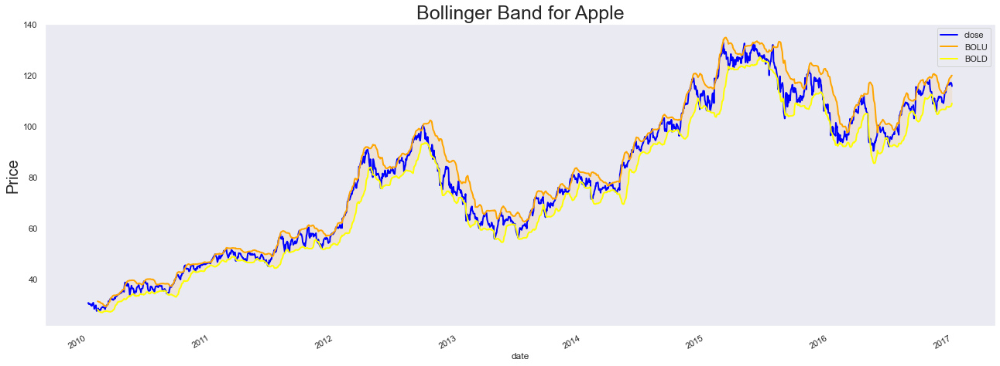

In [28]:
plt.figure(figsize=(20,20))
ax=apple[["close", "BOLU", "BOLD"]].plot(color=['blue', 'orange', 'yellow'])
ax.fill_between(apple.index, apple["BOLD"], apple["BOLU"], facecolor = "orange", alpha=0.1)
plt.title("Bollinger Band for Apple", fontsize = 25)
plt.ylabel("Price", fontsize = 20);

### The Bollinger Band is not too tight and this indicates high volatility.

In [29]:
# create new dataframe for dates from 2016-01-01
apple_new = apple[apple.index >= datetime(2016,1,1)]

<Figure size 1440x1440 with 0 Axes>

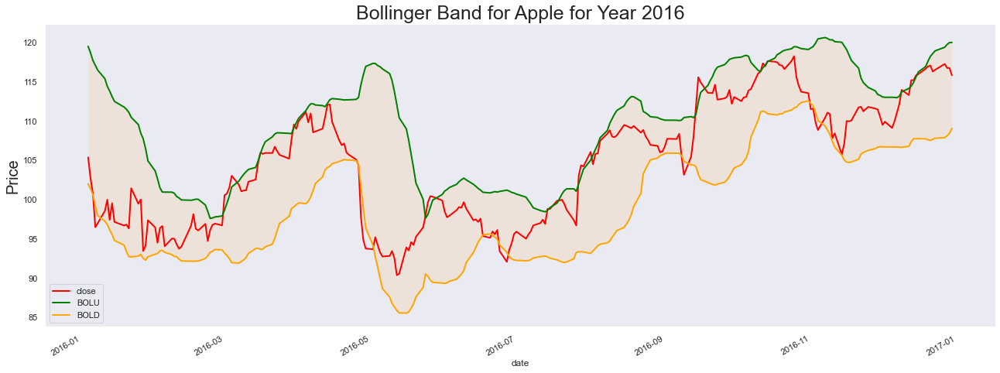

In [30]:
plt.figure(figsize=(20,20))
ax=apple_new[["close", "BOLU", 'BOLD']].plot(color=['red', 'green', 'orange'])
ax.fill_between(apple_new.index, apple_new["BOLD"], apple_new["BOLU"], facecolor='orange', alpha=0.1)
plt.title("Bollinger Band for Apple for Year 2016", fontsize = 25)
plt.ylabel("Price", fontsize = 20);

**The Chart above shows the bollinger band of Apple for the year 2016. The has a better visual so as to be able to visualize the point of bounce and pullback. The price of asset breaking below the lower band around late of 2016-05 indicates oversold which was responsible for the bounce. On the other hand a point, a point arround June shows a pullback when the price crosses the upper band.**

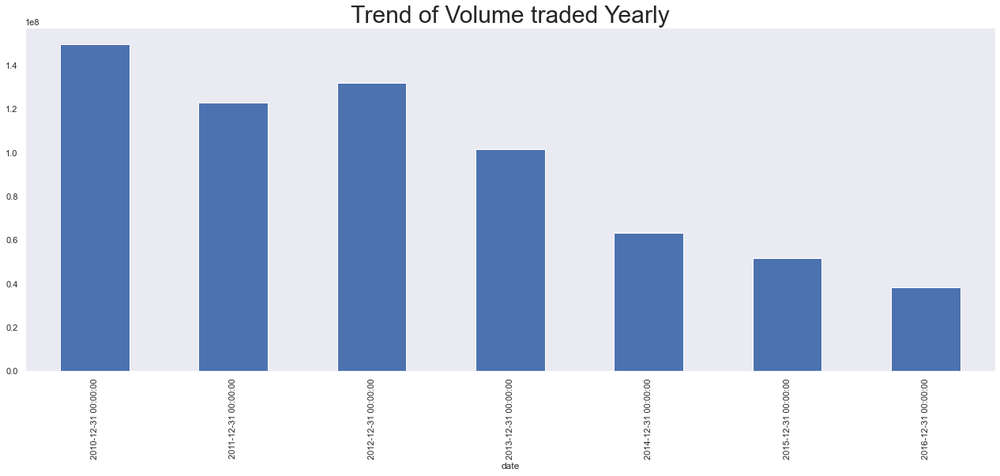

In [31]:
# visualize volume traded resampled yearly  
apple['volume'].resample("Y").mean().plot.bar()
plt.title('Trend of Volume traded Yearly', fontsize=30);

### Insight

**There is a downward trend in the volume over the years.**

### Microsoft Stock Analysis 

In [32]:
#check header
microsoft.head()

,date,symbol,open,close,low,high,volume
544,2010-01-04,MSFT,30.620001,30.950001,30.590000,31.100000,38409100.0
1012,2010-01-05,MSFT,30.850000,30.959999,30.639999,31.100000,49749600.0
1480,2010-01-06,MSFT,30.879999,30.770000,30.520000,31.080000,58182400.0
1948,2010-01-07,MSFT,30.629999,30.450001,30.190001,30.700001,50559700.0
2416,2010-01-08,MSFT,30.280001,30.660000,30.240000,30.879999,51197400.0


In [33]:
#Microsoft prices chart
fig= px.line(
    microsoft, 
    x="date", y=["open", 'high', 'low', 'close'], 
    title="Microsoft Stock Prices"
)
fig.show("notebook")

### Insight

**There was a downward trend in price for Microsoft stock from January to July, 2010. The Market has been in consolidation since then until around Jan, 2013 when the significant upward trend started.**

In [34]:
#microsoft volume
fig = px.line(
    microsoft,
    x="date", 
    y="volume", 
    title= " Microsoft Trading volume"
)
fig.show("notebook")

## Bollinger Band for Microsoft

In [35]:
#setting date as index
microsoft = microsoft.set_index("date")

In [36]:
#creating new necessary columns
microsoft["TP"] = (microsoft["close"] + microsoft['high'] + microsoft["low"])/3
microsoft['std'] = microsoft['TP'].rolling(20).std(ddof=0)
microsoft["MA-TP"] = microsoft["TP"].rolling(20).mean()
microsoft["BOLU"]= microsoft["MA-TP"] + 2*microsoft["std"]
microsoft["BOLD"] = microsoft["MA-TP"] - 2*microsoft['std']

<Figure size 1440x1440 with 0 Axes>

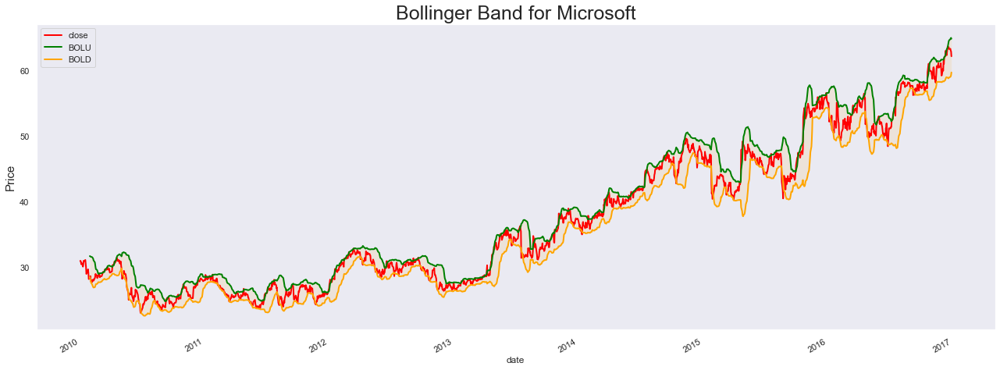

In [37]:
#ploting Bolinger chart
plt.figure(figsize=(20,20))
ax=microsoft[["close", "BOLU", "BOLD"]].plot(color=['red', "green", "orange"])
ax.fill_between(microsoft.index, microsoft["BOLD"], microsoft["BOLU"], facecolor = "orange", alpha=0.1)
plt.title("Bollinger Band for Microsoft", fontsize = 25)
plt.ylabel('Price', fontsize = 15)
plt.show()

In [38]:
#setting a certain date
microsoft_new = microsoft[microsoft.index >= datetime(2016,1,1)]

<Figure size 1440x1440 with 0 Axes>

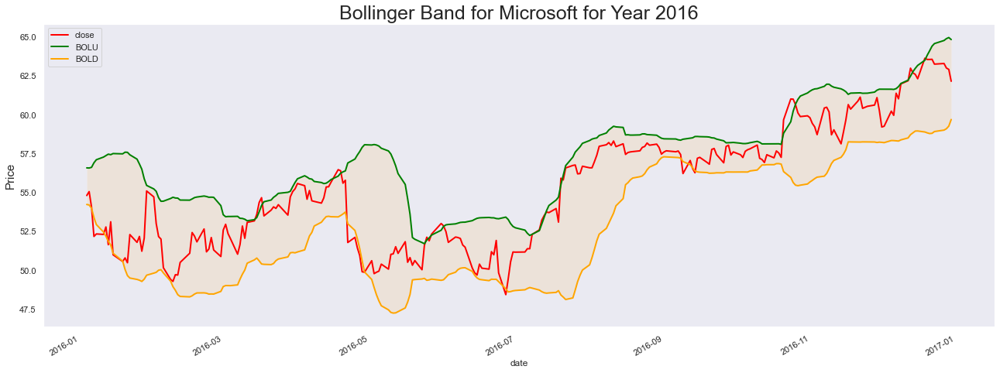

In [39]:
#creating a better visual
plt.figure(figsize=(20,20))
ax=microsoft_new[["close", "BOLU", 'BOLD']].plot(color=['red', 'green', 'orange'])
ax.fill_between(microsoft_new.index, microsoft_new["BOLD"], microsoft_new["BOLU"], facecolor='orange', alpha=0.1)
plt.title("Bollinger Band for Microsoft for Year 2016", fontsize = 25)
plt.ylabel('Price', fontsize = 15)
plt.show()

**Microsoft has a narrow Bollinger which shows volatility of the asset. The Chart above shows the bollinger band of Microsoft for the year 2016. This has a better visual so as to be able to visualize the point of bounce and pullback. The price of asset breaking above the Upperband around 2016-05 indicates a point of overbought which was technically responsible for the pullback afterward. On the other hand a point, a point arround July shows a bounce when the price crosses the lower band.**

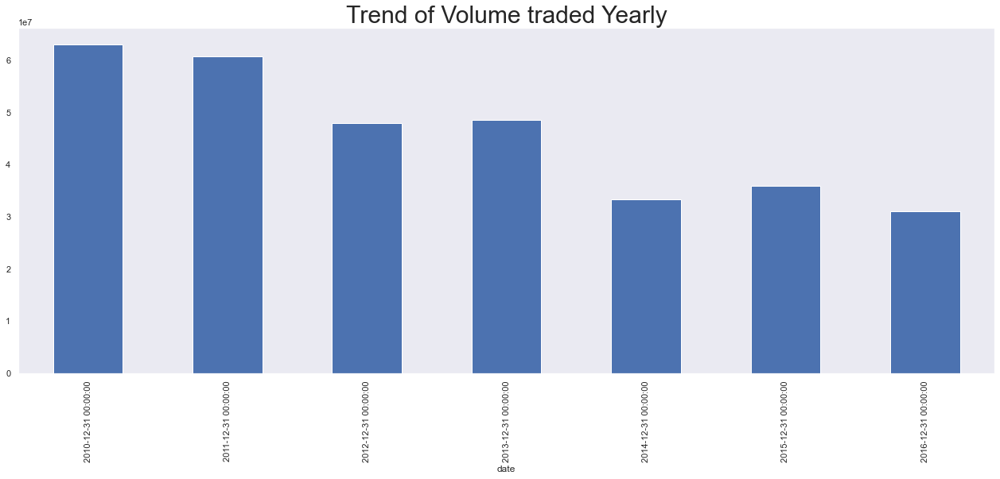

In [40]:
# visualize volume traded resampled yearly  
microsoft['volume'].resample("Y").mean().plot.bar()
plt.title('Trend of Volume traded Yearly', fontsize=30);

# Comparison between Apple, Amazon, and Microsoft


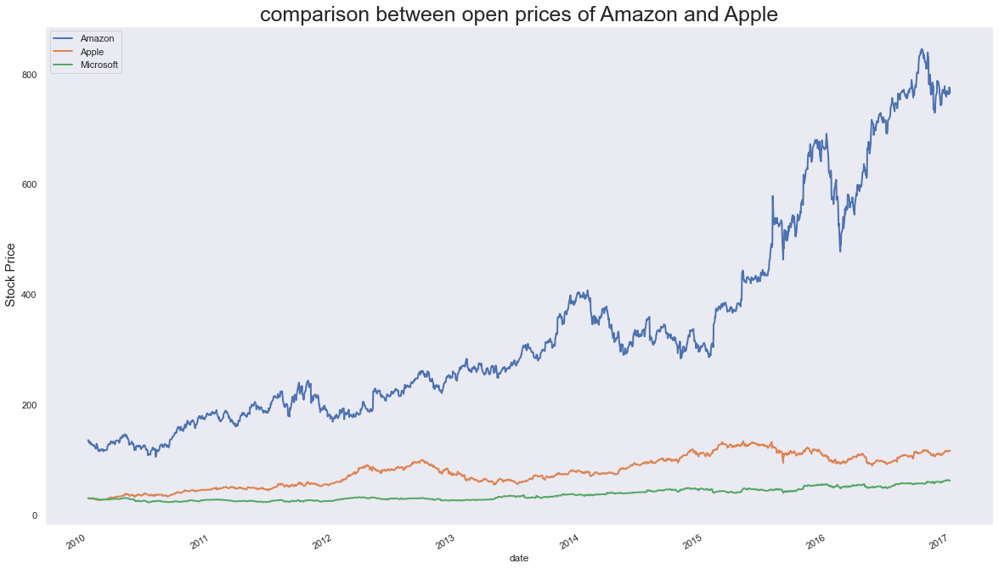

In [41]:
plt.figure(figsize=(20, 12))
amazon['open'].plot(label="Amazon")
apple['open'].plot(label="Apple")
microsoft['open'].plot(label="Microsoft")
plt.title("comparison between open prices of Amazon and Apple", fontsize = 25)
plt.ylabel(' Stock Price', fontsize = 15)
plt.legend()
plt.show()

**Amazon shows a good upward trend of Prices and Price volatility over the years compare to both Apple and Microsoft and also Amazon stock price is higher than the other two.**

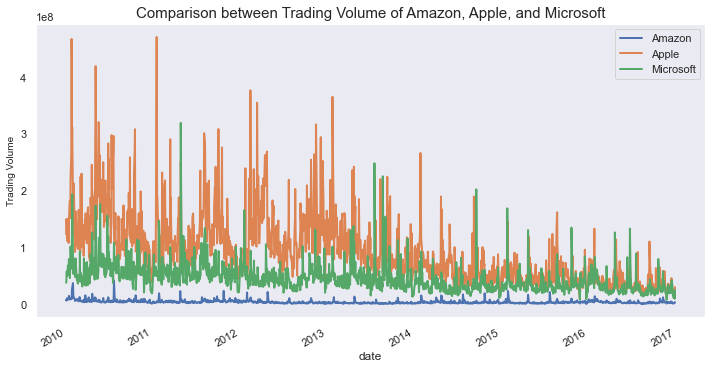

In [42]:
plt.figure(figsize=(12,6))
amazon['volume'].plot(label="Amazon")
apple["volume"].plot(label="Apple")
microsoft["volume"].plot(label="Microsoft")
plt.legend()
plt.title("Comparison between Trading Volume of Amazon, Apple, and Microsoft", fontsize = 15)
plt.ylabel('Trading Volume', fontsize = 10)
plt.show()

**Contrary to the price action, Apple performs the best in terms of Amount of trading volume but it has an obvious downward trend in the trading volume compare to others.** 

### Market Cap for the companies

**Market cap can give an insight to the asset traded more as it takes two factors into account both the price and volume traded.**

In [43]:
#creating a total traded column
amazon["Total Traded"] = amazon["open"] * amazon["volume"]
apple["Total Traded"] = apple["open"] * apple["volume"]
microsoft["Total Traded"] = microsoft["open"] * microsoft["volume"]

In [44]:
# Amazon table with Total traded
amazon.sample(3)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded
date,,,,,,,,,,,,
2010-09-16,AMZN,145.399994,148.130005,145.160004,148.229996,5827000.0,147.173335,8.074387,133.832500,149.981273,117.683727,8.472458e+08
2011-03-22,AMZN,164.070007,162.600006,162.250000,164.440002,3611400.0,163.096669,4.931698,168.950834,178.814230,159.087437,5.925224e+08
2016-07-15,AMZN,746.549988,735.440002,734.049988,746.549988,3121400.0,738.679993,17.094081,724.411834,758.599996,690.223672,2.330281e+09


In [45]:
#Apple's table with Total traded
apple.sample(3)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded
date,,,,,,,,,,,,
2013-08-13,AAPL,67.277145,69.938568,66.864288,70.665718,220485300.0,69.156192,2.339555,64.208429,68.887538,59.529319,1.483362e+10
2016-09-30,AAPL,112.459999,113.050003,111.800003,113.370003,36379100.0,112.740003,3.509765,111.024333,118.043863,104.004804,4.091194e+09
2016-03-03,AAPL,100.580002,101.500000,100.449997,101.709999,36955700.0,101.219999,1.989616,96.446000,100.425232,92.466768,3.717004e+09


In [46]:
#microsoft's table with Total traded
microsoft.sample(3)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded
date,,,,,,,,,,,,
2013-06-05,MSFT,34.599998,34.779999,34.430000,34.889999,46025100.0,34.699999,0.873140,34.225334,35.971613,32.479054,1.592468e+09
2010-11-05,MSFT,27.170000,26.850000,26.530001,27.190001,110953700.0,26.856667,0.844736,25.866833,27.556305,24.177362,3.014612e+09
2010-10-08,MSFT,24.620001,24.570000,24.370001,24.650000,41327800.0,24.530000,0.376501,24.723500,25.476501,23.970499,1.017490e+09


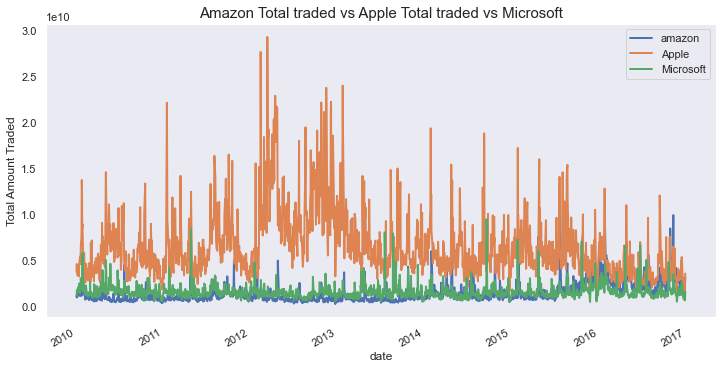

In [47]:
# Total traded comparison
plt.figure(figsize=(12,6))
amazon["Total Traded"].plot(label='amazon')
apple['Total Traded'].plot(label="Apple")
microsoft['Total Traded'].plot(label="Microsoft")
plt.ylabel("Total Amount Traded")
plt.legend()
plt.title("Amazon Total traded vs Apple Total traded vs Microsoft", fontsize = 15)
plt.show()

 **As we can observe, Apple is traded on the higher side compare to the other two.** 

### Spike in Total Volume Traded

The lines of code below  extract the date of usual upward spike in the total traded of the three companies

In [48]:
apple['Total Traded'].argmax()

553

In [49]:
apple.iloc[apple['Total Traded'].argmax()]

symbol                        AAPL
open                     82.578575
close                    84.225716
low                      82.199997
high                     84.959999
volume                 354711000.0
TP                       83.795237
std                       3.015962
MA-TP                    75.945714
BOLU                     81.977639
BOLD                      69.91379
Total Traded    29291528967.477734
Name: 2012-03-14 00:00:00, dtype: object

In [50]:
microsoft["Total Traded"].argmax()

1186

In [51]:
microsoft.iloc[microsoft["Total Traded"].argmax()]

symbol                     MSFT
open                  46.810001
close                     47.52
low                   46.599998
high                      47.57
volume              202522400.0
TP                    47.229999
std                    0.810606
MA-TP                   45.9005
BOLU                  47.521712
BOLD                  44.279287
Total Traded    9480073746.5224
Name: 2014-09-19 00:00:00, dtype: object

In [52]:
amazon["Total Traded"].argmax()

1398

In [53]:
amazon.iloc[amazon["Total Traded"].argmax()]

symbol                     AMZN
open                  578.98999
close                529.419983
low                  529.349976
high                 580.570007
volume               21909400.0
TP                   546.446655
std                   29.163546
MA-TP                459.270501
BOLU                 517.597593
BOLD                 400.943409
Total Traded    12685323286.906
Name: 2015-07-24 00:00:00, dtype: object

### Moving Average

In [54]:
amazon['MA-50'] = amazon['close'].rolling(50).mean()
apple["MA-50"] = apple['close'].rolling(50).mean()
microsoft["MA-50"] = microsoft['close'].rolling(50).mean()

In [55]:
amazon['MA-20'] = amazon['close'].rolling(20).mean()
apple["MA-20"] = apple['close'].rolling(20).mean()
microsoft["MA-20"] = microsoft['close'].rolling(20).mean()

#### Amazon

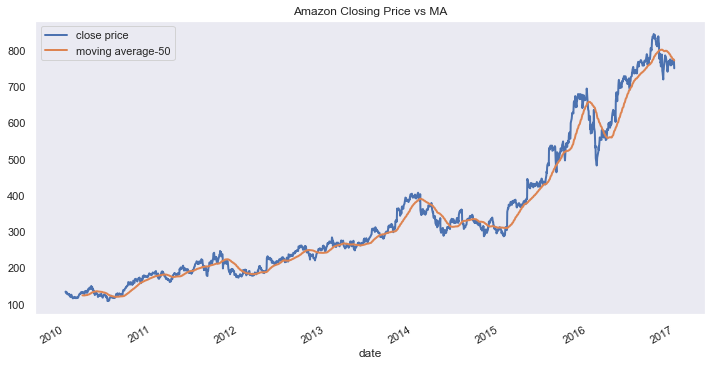

In [56]:
#Amazon's Moving average
plt.figure(figsize=(12,6))
amazon['close'].plot(label="close price")
amazon['MA-50'].plot(label="moving average-50")
plt.legend()
plt.title("Amazon Closing Price vs MA")
plt.show()

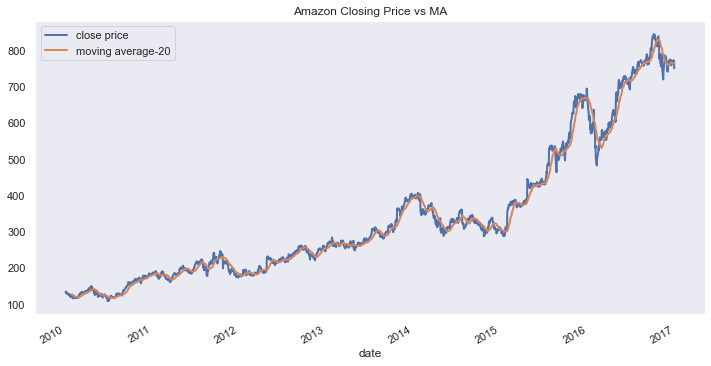

In [57]:
plt.figure(figsize=(12,6))
amazon['close'].plot(label="close price")
amazon['MA-20'].plot(label="moving average-20")
plt.legend()
plt.title("Amazon Closing Price vs MA")
plt.show()

#### Apple

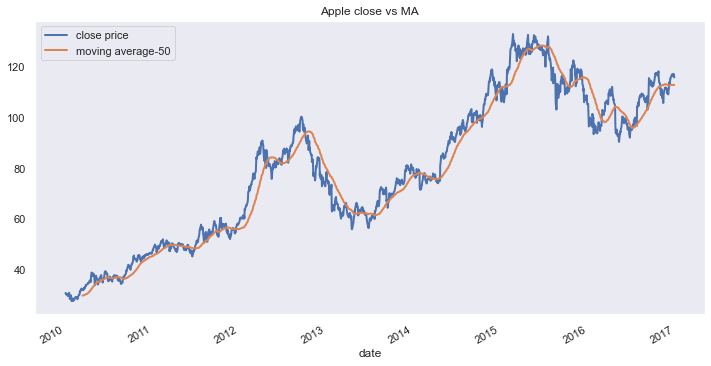

In [58]:
#Apple's moving average
plt.figure(figsize=(12,6))
apple['close'].plot(label="close price")
apple['MA-50'].plot(label="moving average-50")
plt.title("Apple close vs MA")
plt.legend()
plt.show()

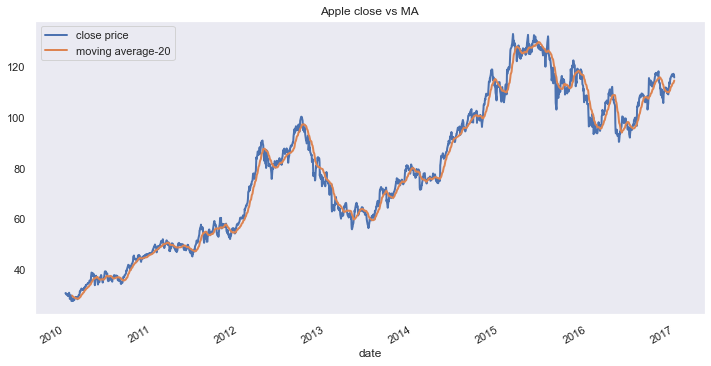

In [59]:
plt.figure(figsize=(12,6))
apple['close'].plot(label="close price")
apple['MA-20'].plot(label="moving average-20")
plt.title("Apple close vs MA")
plt.legend()
plt.show()

#### Microsoft

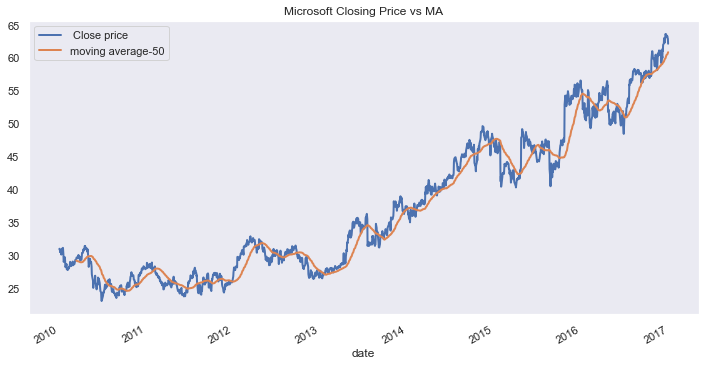

In [60]:
#microsoft Moving Average
plt.figure(figsize=(12,6))
microsoft['close'].plot(label=" Close price")
microsoft['MA-50'].plot(label="moving average-50")
plt.title("Microsoft Closing Price vs MA")
plt.legend()
plt.show()

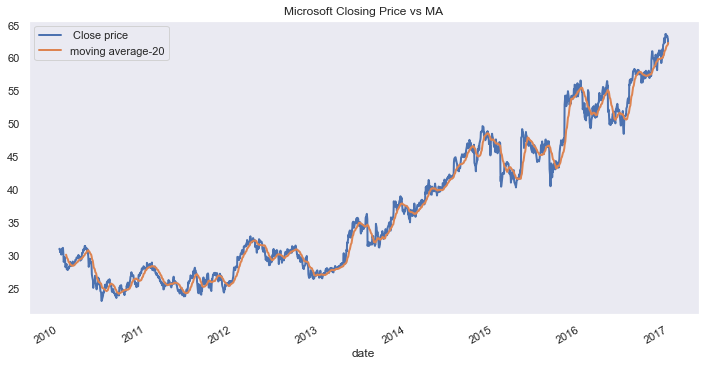

In [61]:
plt.figure(figsize=(12,6))
microsoft['close'].plot(label=" Close price")
microsoft['MA-20'].plot(label="moving average-20")
plt.title("Microsoft Closing Price vs MA")
plt.legend()
plt.show()

**The moving Averages smoothing the lines so as to better visualize the movement of the trends.**

### Cross Over SMA Strategy 

**Using the cross over SMA strategy to predict the sell and buy signal**

In [62]:
amazon['Signal'] = 0.0
amazon['Signal'] = np.where(amazon['MA-20'] > amazon['MA-50'], 1.0, 0.0)

In [63]:
amazon.sample(4)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20,Signal
date,,,,,,,,,,,,,,,
2010-12-10,AMZN,174.880005,175.619995,173.360001,175.949997,3565500.0,174.976664,6.849416,171.427167,185.125999,157.728335,6.235347e+08,166.497199,171.398499,1.0
2015-06-30,AMZN,434.200012,434.089996,430.459991,435.570007,2596900.0,433.373331,5.767919,432.825502,444.361340,421.289664,1.127574e+09,427.816601,432.764003,1.0
2015-12-08,AMZN,663.130005,677.330017,659.789978,679.989990,3651900.0,672.369995,10.497016,666.061833,687.055864,645.067802,2.421684e+09,613.426801,666.495502,1.0
2015-09-04,AMZN,497.649994,499.000000,495.640015,502.850006,2692500.0,499.163340,19.240306,512.665499,551.146112,474.184887,1.339923e+09,494.644403,512.127499,1.0


In [64]:
amazon['Position'] = amazon['Signal'].diff()
amazon.head(4)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20,Signal,Position
date,,,,,,,,,,,,,,,,
2010-01-04,AMZN,136.250000,133.899994,133.139999,136.610001,7599900.0,134.549998,NaN,NaN,NaN,NaN,1.035486e+09,NaN,NaN,0.0,NaN
2010-01-05,AMZN,133.429993,134.690002,131.809998,135.479996,8851900.0,133.993332,NaN,NaN,NaN,NaN,1.181109e+09,NaN,NaN,0.0,0.0
2010-01-06,AMZN,134.600006,132.250000,131.649994,134.729996,7178800.0,132.876663,NaN,NaN,NaN,NaN,9.662665e+08,NaN,NaN,0.0,0.0
2010-01-07,AMZN,132.009995,130.000000,128.800003,132.320007,11030200.0,130.373337,NaN,NaN,NaN,NaN,1.456097e+09,NaN,NaN,0.0,0.0


In [65]:
amazon_cross = amazon[amazon.index >= datetime(2016,1,1)]
apple_cross = amazon[apple.index >= datetime(2016,1,1)]
microsoft_cross =  microsoft[microsoft.index >= datetime(2016,1,1)]

In [66]:
amazon_cross

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20,Signal,Position
date,,,,,,,,,,,,,,,,
2016-01-04,AMZN,656.289978,636.989990,627.510010,657.719971,9314500.0,640.739990,11.928722,666.938170,690.795615,643.080726,6.113013e+09,655.335602,666.972006,1.0,0.0
2016-01-05,AMZN,646.859985,633.789978,627.650024,646.909973,5822600.0,636.116658,13.661357,665.263669,692.586384,637.940954,3.766407e+09,656.733202,665.029504,1.0,0.0
2016-01-06,AMZN,622.000000,632.650024,620.309998,639.789978,5329200.0,630.916667,15.540708,663.379668,694.461084,632.298252,3.314762e+09,657.405602,663.170505,1.0,0.0
2016-01-07,AMZN,621.799988,607.940002,605.210022,630.000000,7074900.0,614.383341,18.684169,660.480336,697.848674,623.111997,4.399173e+09,657.392202,659.701004,1.0,0.0
2016-01-08,AMZN,619.659973,607.049988,606.000000,624.140015,5512900.0,612.396668,21.344299,657.775669,700.464268,615.087070,3.416123e+09,657.313002,656.814004,0.0,-1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-12-23,AMZN,764.549988,760.590027,757.989990,766.500000,1976900.0,761.693339,8.065244,762.891169,779.021657,746.760682,1.511439e+09,775.644803,762.557004,0.0,0.0
2016-12-27,AMZN,763.400024,771.400024,761.200012,774.650024,2627400.0,769.083353,8.055304,762.878503,778.989112,746.767894,2.005757e+09,774.613603,762.788504,0.0,0.0
2016-12-28,AMZN,776.250000,772.130005,770.500000,780.000000,3279100.0,774.210002,8.422107,763.360169,780.204383,746.515956,2.545401e+09,773.797203,763.269003,0.0,0.0


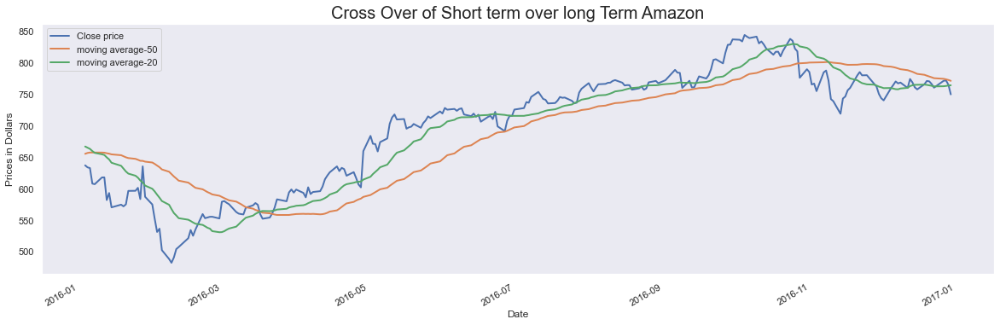

In [67]:
plt.figure(figsize=(20,6))
amazon_cross['close'].plot(label="Close price")
amazon_cross['MA-50'].plot(label="moving average-50")
amazon_cross['MA-20'].plot(label="moving average-20")
plt.title("Cross Over of Short term over long Term Amazon", fontsize=20)
plt.xlabel('Date')
plt.ylabel('Prices in Dollars')
plt.legend()
plt.show()

In [68]:
apple_cross.head(4)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20,Signal,Position
date,,,,,,,,,,,,,,,,
2016-01-04,AMZN,656.289978,636.989990,627.510010,657.719971,9314500.0,640.739990,11.928722,666.938170,690.795615,643.080726,6.113013e+09,655.335602,666.972006,1.0,0.0
2016-01-05,AMZN,646.859985,633.789978,627.650024,646.909973,5822600.0,636.116658,13.661357,665.263669,692.586384,637.940954,3.766407e+09,656.733202,665.029504,1.0,0.0
2016-01-06,AMZN,622.000000,632.650024,620.309998,639.789978,5329200.0,630.916667,15.540708,663.379668,694.461084,632.298252,3.314762e+09,657.405602,663.170505,1.0,0.0
2016-01-07,AMZN,621.799988,607.940002,605.210022,630.000000,7074900.0,614.383341,18.684169,660.480336,697.848674,623.111997,4.399173e+09,657.392202,659.701004,1.0,0.0


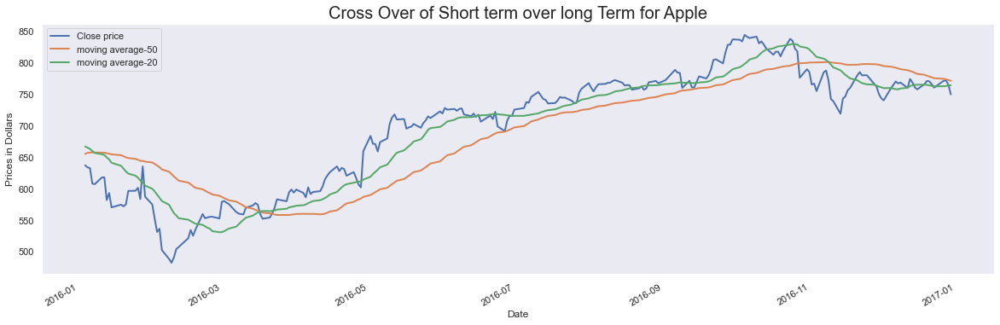

In [69]:
plt.figure(figsize=(20,6))
apple_cross['close'].plot(label="Close price")
apple_cross['MA-50'].plot(label="moving average-50")
apple_cross['MA-20'].plot(label="moving average-20")
plt.title("Cross Over of Short term over long Term for Apple", fontsize=20)
plt.xlabel('Date')
plt.ylabel('Prices in Dollars')
plt.legend()
plt.show()

In [70]:
microsoft_cross.head(2)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20
date,,,,,,,,,,,,,,
2016-01-04,MSFT,54.32,54.799999,53.389999,54.799999,53778000.0,54.329999,0.587482,55.399,56.573963,54.224036,2.921221e+09,54.4006,55.444
2016-01-05,MSFT,54.93,55.049999,54.540001,55.389999,34079700.0,54.993333,0.594064,55.378,56.566127,54.189872,1.871998e+09,54.5410,55.401


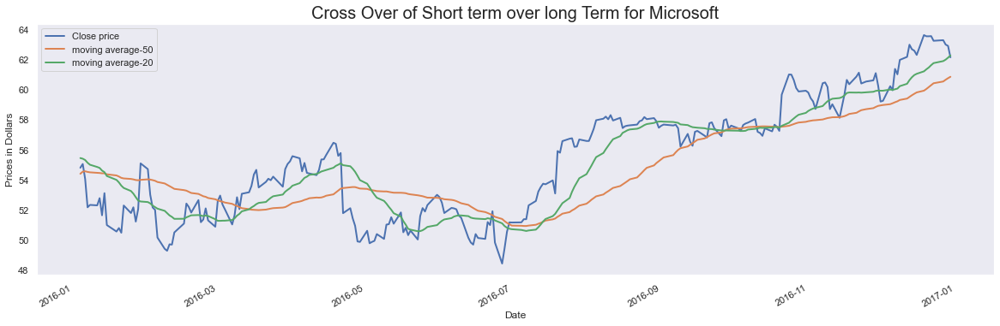

In [71]:
plt.figure(figsize=(20,6))
microsoft_cross['close'].plot(label="Close price")
microsoft_cross['MA-50'].plot(label="moving average-50")
microsoft_cross['MA-20'].plot(label="moving average-20")
plt.title("Cross Over of Short term over long Term for Microsoft", fontsize=20)
plt.xlabel('Date')
plt.ylabel('Prices in Dollars')
plt.legend()
plt.show()

### Insight
- The Cross Over Strategy can be used to predict when to buy or sell a particular asset. 
- Buy = When the Short term MA (MA-20) is crossing Above the Long Term(MA-50)
- Sell =  When the Short term MA(MA-20) cross below the Long term(MA-50)

### Relationship between Open Price and Close Price Percentage of Three Companies

**To get the relationship between the open prices, close Price Percentage of the companies, a new dataframe was formed (tech.company). Same goes with percent close price.**

In [72]:
tech_company = pd.concat([amazon['open'], apple['open'], microsoft['open']], axis=1)
tech_company.columns = ['Amazon open', "Apple open", "microsoft"]

In [73]:
close_df = pd.concat([amazon['close'], apple['close'], microsoft['close']], axis=1)
close_df.columns = ['Amazon close', "Apple close", "Microsoft close"]

In [74]:
close_df_percent = close_df.pct_change()

In [75]:
close_df_percent

,Amazon close,Apple close,Microsoft close
date,,,
2010-01-04,NaN,NaN,NaN
2010-01-05,0.005900,0.001729,0.000323
2010-01-06,-0.018116,-0.015906,-0.006137
2010-01-07,-0.017013,-0.001849,-0.010400
2010-01-08,0.027077,0.006648,0.006897
...,...,...,...
2016-12-23,-0.007503,0.001978,-0.004878
2016-12-27,0.014213,0.006351,0.000632
2016-12-28,0.000946,-0.004264,-0.004583


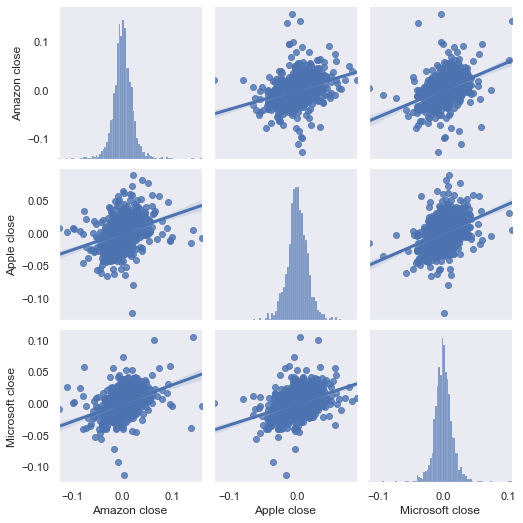

In [76]:
# close price relationshp
sns.pairplot(close_df_percent,  kind="reg");

# Insight
The Relationship between the the open prices of the assets is positive linear but not perfect 

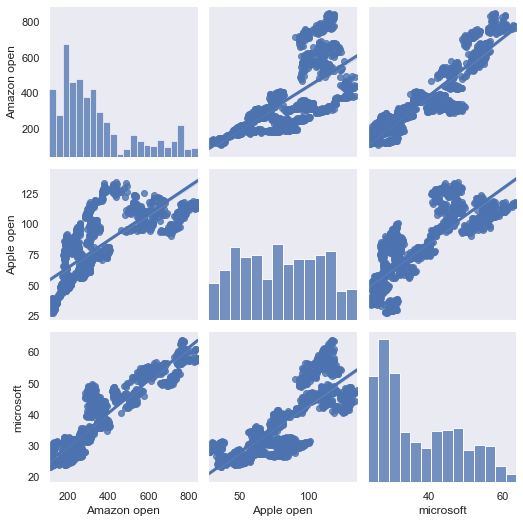

In [77]:
# open price relationshp
sns.pairplot(tech_company, kind='reg');

The relationship between Microsoft and Amazon is perfectly positively linear

#### Correlation Heatmap

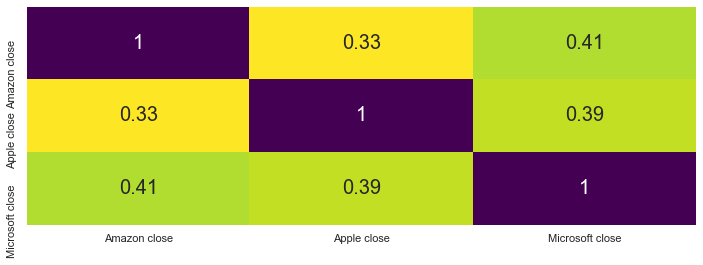

In [78]:
plt.figure(figsize=(12, 4))
sns.heatmap(close_df_percent.corr(), annot = True, cmap="viridis_r", cbar=False);

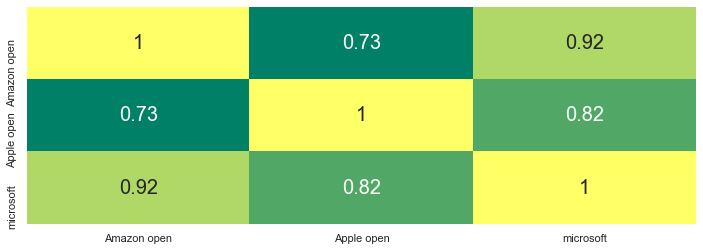

In [79]:
plt.figure(figsize=(12, 4))
sns.heatmap(tech_company.corr(), annot=True, cmap="summer", cbar=False);

### Financial analysis

#### Daily percentage change

**This is used to calculate the daily Return of each asset. P(t) = Price at a Particular day while P(t-1) = Price at the previous day. This can be used to Daily Profit or Loss of a Particular asset. A +sign indicates Profit while a negative indicates a loss. The Return was used here to access the risk of investing in each of the stocks.**

***R_t=  P_t/P_(t-1) -1*** 

In [80]:
amazon["AMZN Return"] = (amazon['close']/amazon['close'].shift(1))-1
amazon.sample(5)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20,Signal,Position,AMZN Return
date,,,,,,,,,,,,,,,,,
2012-11-13,AMZN,225.119995,226.600006,224.710007,227.899994,2629800.0,226.403336,6.312594,234.667167,247.292355,222.041979,5.920206e+08,246.255401,234.316501,0.0,0.0,0.000574
2012-12-13,AMZN,251.110001,251.250000,250.020004,254.539993,2460200.0,251.936666,10.078780,244.082833,264.240394,223.925273,6.177808e+08,241.318801,244.478501,1.0,0.0,-0.002026
2016-08-25,AMZN,756.000000,759.219971,754.739990,760.559998,1623000.0,758.173320,4.798337,763.425997,773.022671,753.829323,1.226988e+09,743.190399,763.653998,1.0,0.0,0.002601
2010-12-22,AMZN,185.000000,184.759995,184.110001,185.449997,2578100.0,184.773331,2.869507,177.544499,183.283514,171.805485,4.769485e+08,170.206799,177.592999,1.0,0.0,0.000054
2015-03-12,AMZN,368.820007,374.239990,367.519989,375.500000,2810000.0,372.419993,4.808690,379.423834,389.041213,369.806455,1.036384e+09,344.487000,379.455498,1.0,0.0,0.021481


In [81]:
apple['APPL Return'] = (apple['close']/apple['close'].shift(1))-1
apple.sample(5)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20,APPL Return
date,,,,,,,,,,,,,,,
2010-11-09,AAPL,45.864285,45.154285,44.928570,45.900002,95886000.0,45.327619,0.779742,44.254857,45.814341,42.695373,4.397743e+09,41.457228,44.282714,-0.007972
2012-12-10,AAPL,75.000000,75.688568,74.511429,76.930000,157621100.0,75.709999,3.119271,79.844976,86.083517,73.606435,1.182158e+10,85.256628,79.848429,-0.006432
2012-05-10,AAPL,82.082855,81.502853,81.205711,82.268570,83300000.0,81.659045,2.337763,83.706333,88.381860,79.030807,6.837502e+09,84.050771,83.521571,0.002354
2010-11-12,AAPL,45.142857,44.004284,43.375713,45.214287,198961700.0,44.198095,0.711609,44.459809,45.883028,43.036591,8.981699e+09,42.020400,44.465000,-0.027223
2013-11-06,AAPL,74.878571,74.417145,74.028572,74.980003,55843900.0,74.475240,1.871944,73.523452,77.267341,69.779564,4.181511e+09,70.787971,73.593143,-0.008621


In [82]:
microsoft['MSFT Return'] = (microsoft['close']/microsoft['close'].shift(1))-1
microsoft.sample(4)

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20,MSFT Return
date,,,,,,,,,,,,,,,
2013-05-31,MSFT,34.820000,34.900002,34.790001,35.279999,56165700.0,34.990001,0.819433,33.986834,35.625699,32.347968,1.955690e+09,31.4748,34.0520,-0.003711
2016-11-30,MSFT,60.860001,60.259998,60.220001,61.180000,34655400.0,60.553333,0.850737,59.928500,61.629974,58.227026,2.109128e+09,58.9134,59.9315,-0.013587
2013-06-10,MSFT,35.509998,35.470001,35.139999,35.650002,35994500.0,35.420001,0.685623,34.599833,35.971079,33.228588,1.278165e+09,32.3108,34.6805,-0.005607
2015-06-01,MSFT,47.060001,47.230000,46.619999,47.770000,28837300.0,47.206666,0.556928,47.492167,48.606023,46.378310,1.357083e+09,44.8906,47.4585,0.007896


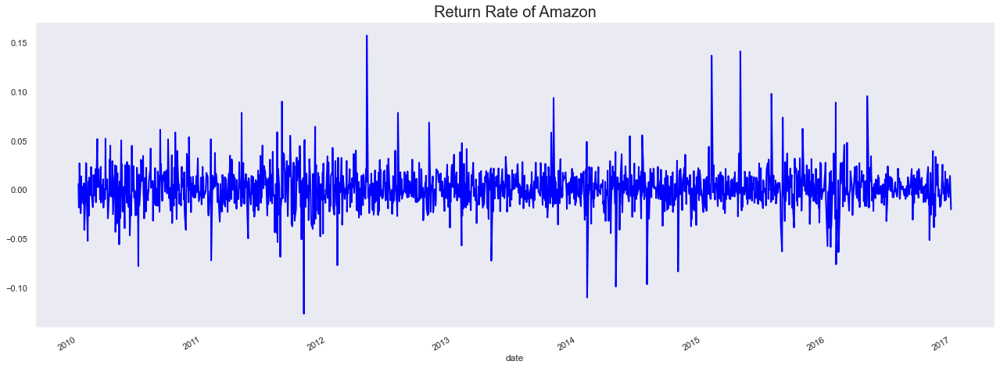

In [83]:
amazon['AMZN Return'].plot(label="Amazon", color="blue")
plt.title("Return Rate of Amazon", fontsize=20)
plt.show()

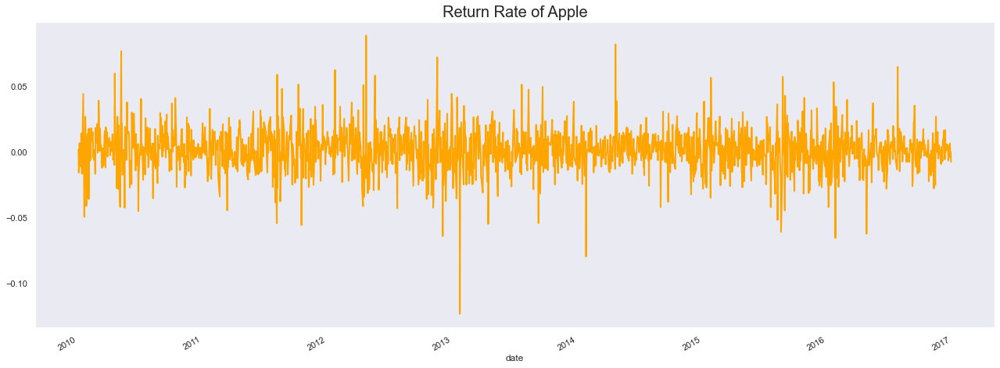

In [84]:
apple['APPL Return'].plot(label="Apple", color="orange")
plt.title("Return Rate of Apple", fontsize=20)
plt.show()

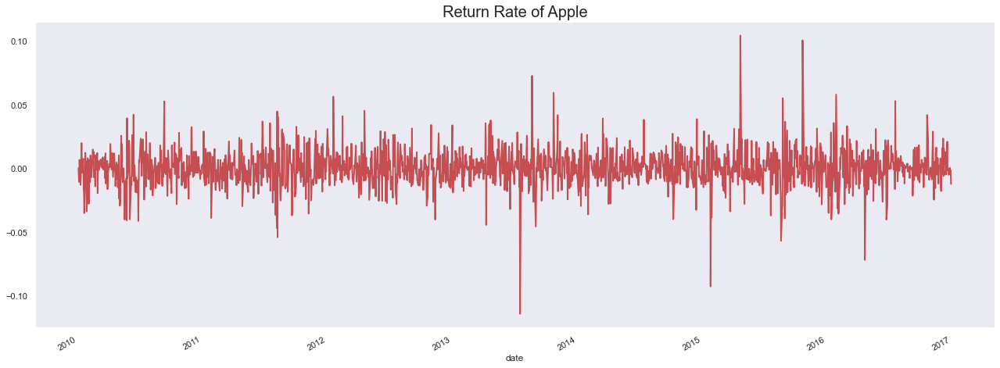

In [85]:
microsoft['MSFT Return'].plot(label="Microsoft", color="r")
plt.title("Return Rate of Apple", fontsize=20)
plt.show()

**The graphs above show the return rate of each asset over the years. Looking at the chart, it can be deduced that amazon has the best profit return among the three assets**

In [86]:
amazon_return = amazon[['AMZN Return']]
apple_return = apple[['APPL Return']]
microsoft_return = microsoft[['MSFT Return']]

In [87]:
# joining the three dataframe
return_df = pd.concat([amazon_return, apple_return, microsoft_return], axis=0)
return_df.sample(5)

,AMZN Return,APPL Return,MSFT Return
date,,,
2012-09-10,NaN,NaN,-0.007431
2012-03-07,NaN,NaN,0.008872
2010-11-22,NaN,NaN,0.001557
2011-04-25,-0.002528,NaN,NaN
2015-11-03,NaN,NaN,0.017092


In [88]:
# Annualize returns
annualized_return = return_df.mean()*253
annualized_return

AMZN Return    0.299973
APPL Return    0.225967
MSFT Return    0.127129
dtype: float64

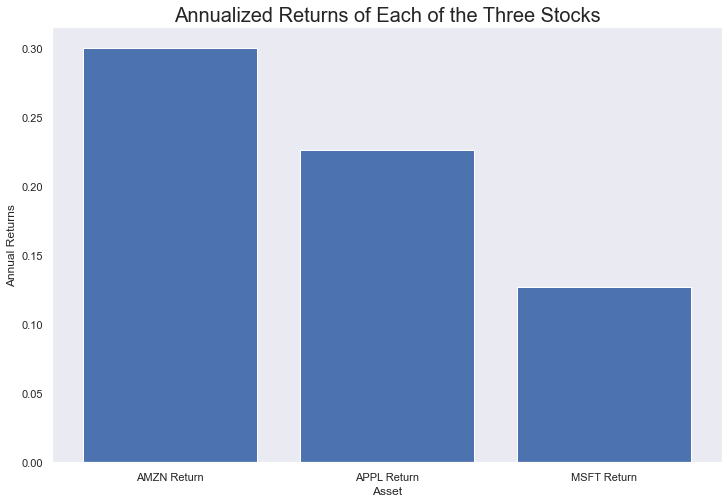

In [89]:
plt.figure(figsize=(12,8))
plt.bar(annualized_return.index, annualized_return)
plt.xlabel('Asset')
plt.ylabel('Annual Returns')
plt.title('Annualized Returns of Each of the Three Stocks', fontsize=20)
plt.show()

**The chart shows the annualised return of the three assets with Amazon being the best performer**

### Volatility

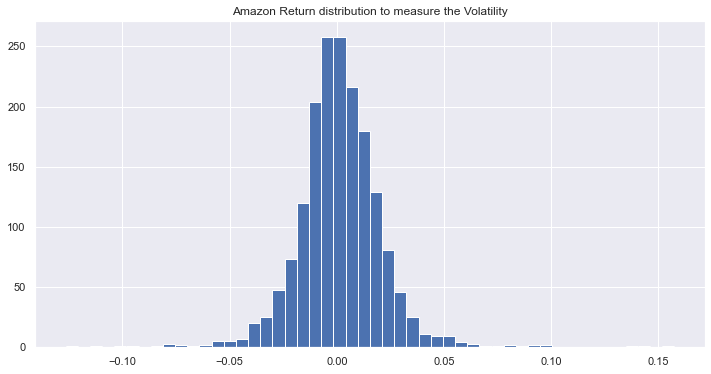

In [90]:
plt.figure(figsize=(12,6))
amazon["AMZN Return"].hist(bins=50)
plt.title("Amazon Return distribution to measure the Volatility");

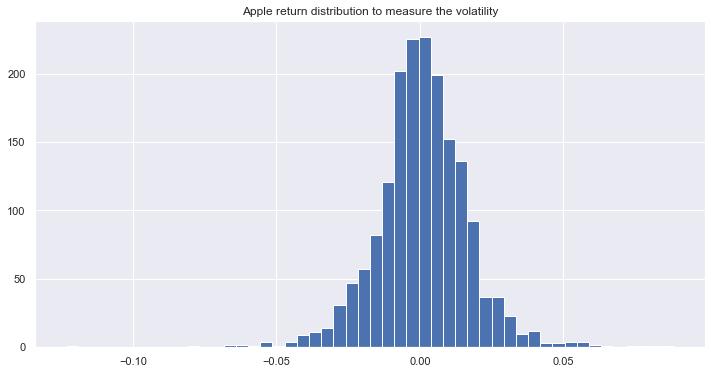

In [91]:
plt.figure(figsize=(12,6))
apple["APPL Return"].hist(bins=50)
plt.title("Apple return distribution to measure the volatility");

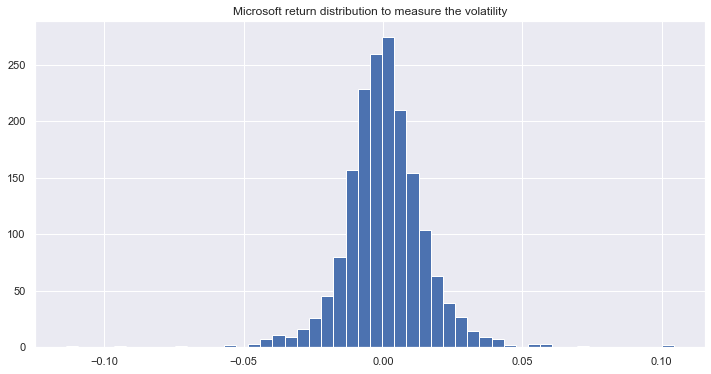

In [92]:
plt.figure(figsize=(12,6))
microsoft["MSFT Return"].hist(bins=50)
plt.title("Microsoft return distribution to measure the volatility");

### Comparing the volatility of the three

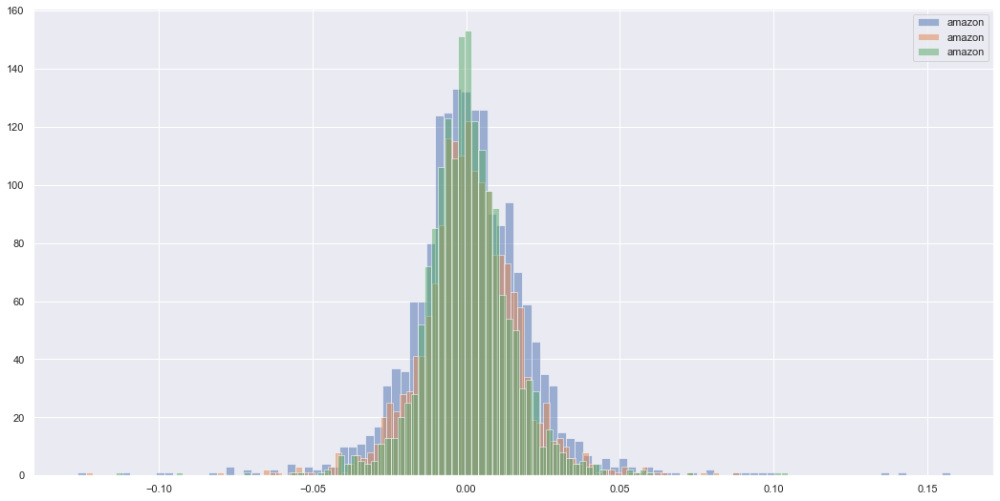

In [93]:
plt.figure(figsize=(18,9))
amazon["AMZN Return"].hist(bins=100, label="amazon", alpha=0.5)
apple["APPL Return"].hist(bins=100, label="amazon", alpha=0.5)
microsoft["MSFT Return"].hist(bins=100, label="amazon", alpha=0.5)
plt.legend();

***The Chart above shows an almost equal spread around the mean. This indicates that they are almost equal in volatility as amazon as most volality. This can be better visualize by the KDE diagrams below.***

**Note: The three companies have very close spread, so there volatility is close.**

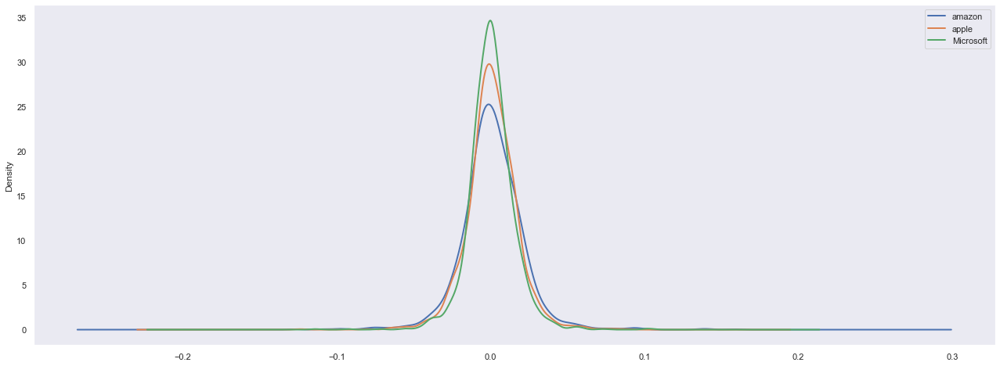

In [94]:
amazon["AMZN Return"].plot(kind="kde", label ="amazon")
apple["APPL Return"].plot(kind="kde", label ="apple")
microsoft["MSFT Return"].plot(kind="kde", label ="Microsoft")
plt.legend();

## Cummulative Return

**The Cummulative Return helps to keep track on stock changes over a long Period of Time. Unlike Daily Return, it gives back Dividend. It is measures against one dollar.**

***I(t) = (1 + r(t))I(t-1)***. 

In [95]:
amazon["Cummulative Return"] = (1 + amazon["AMZN Return"]).cumprod()
apple["Cummulative Return"] = (1 + apple["APPL Return"]).cumprod()
microsoft["Cummulative Return"] = (1 + microsoft["MSFT Return"]).cumprod()

In [96]:
display(amazon.head())
display(apple.head())
display(microsoft.head())

,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20,Signal,Position,AMZN Return,Cummulative Return
date,,,,,,,,,,,,,,,,,,
2010-01-04,AMZN,136.250000,133.899994,133.139999,136.610001,7599900.0,134.549998,NaN,NaN,NaN,NaN,1.035486e+09,NaN,NaN,0.0,NaN,NaN,NaN
2010-01-05,AMZN,133.429993,134.690002,131.809998,135.479996,8851900.0,133.993332,NaN,NaN,NaN,NaN,1.181109e+09,NaN,NaN,0.0,0.0,0.005900,1.005900
2010-01-06,AMZN,134.600006,132.250000,131.649994,134.729996,7178800.0,132.876663,NaN,NaN,NaN,NaN,9.662665e+08,NaN,NaN,0.0,0.0,-0.018116,0.987677
2010-01-07,AMZN,132.009995,130.000000,128.800003,132.320007,11030200.0,130.373337,NaN,NaN,NaN,NaN,1.456097e+09,NaN,NaN,0.0,0.0,-0.017013,0.970874
2010-01-08,AMZN,130.559998,133.520004,129.029999,133.679993,9830500.0,132.076665,NaN,NaN,NaN,NaN,1.283470e+09,NaN,NaN,0.0,0.0,0.027077,0.997162


,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20,APPL Return,Cummulative Return
date,,,,,,,,,,,,,,,,
2010-01-04,AAPL,30.490000,30.572857,30.340000,30.642857,123432400.0,30.518571,NaN,NaN,NaN,NaN,3.763454e+09,NaN,NaN,NaN,NaN
2010-01-05,AAPL,30.657143,30.625713,30.464285,30.798571,150476200.0,30.629523,NaN,NaN,NaN,NaN,4.613170e+09,NaN,NaN,0.001729,1.001729
2010-01-06,AAPL,30.625713,30.138571,30.107143,30.747143,138040000.0,30.330952,NaN,NaN,NaN,NaN,4.227573e+09,NaN,NaN,-0.015906,0.985795
2010-01-07,AAPL,30.250000,30.082857,29.864286,30.285715,119282800.0,30.077620,NaN,NaN,NaN,NaN,3.608305e+09,NaN,NaN,-0.001849,0.983973
2010-01-08,AAPL,30.042856,30.282858,29.865715,30.285715,111902700.0,30.144763,NaN,NaN,NaN,NaN,3.361877e+09,NaN,NaN,0.006648,0.990514


,symbol,open,close,low,high,volume,TP,std,MA-TP,BOLU,BOLD,Total Traded,MA-50,MA-20,MSFT Return,Cummulative Return
date,,,,,,,,,,,,,,,,
2010-01-04,MSFT,30.620001,30.950001,30.590000,31.100000,38409100.0,30.880000,NaN,NaN,NaN,NaN,1.176087e+09,NaN,NaN,NaN,NaN
2010-01-05,MSFT,30.850000,30.959999,30.639999,31.100000,49749600.0,30.899999,NaN,NaN,NaN,NaN,1.534775e+09,NaN,NaN,0.000323,1.000323
2010-01-06,MSFT,30.879999,30.770000,30.520000,31.080000,58182400.0,30.790000,NaN,NaN,NaN,NaN,1.796672e+09,NaN,NaN,-0.006137,0.994184
2010-01-07,MSFT,30.629999,30.450001,30.190001,30.700001,50559700.0,30.446668,NaN,NaN,NaN,NaN,1.548644e+09,NaN,NaN,-0.010400,0.983845
2010-01-08,MSFT,30.280001,30.660000,30.240000,30.879999,51197400.0,30.593333,NaN,NaN,NaN,NaN,1.550257e+09,NaN,NaN,0.006897,0.990630


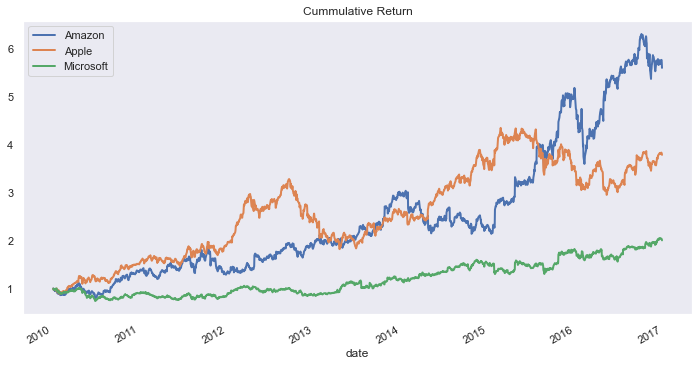

In [97]:
plt.figure(figsize=(12,6))
amazon["Cummulative Return"].plot(label="Amazon")
apple["Cummulative Return"].plot(label="Apple")
microsoft["Cummulative Return"].plot(label="Microsoft")
plt.legend()
plt.title("Cummulative Return")
plt.show()

**Overall, amazon has a better cummulative return because *$1 invested in Amazon back in 2010 is equivalent to $5.5* in 2017.**

## MODEL PREDICTION

**ONE DAY AHEAD PREDICTION FOR AMAZON**

In [98]:
df = amazon.filter(['close'])
df1 = df.values

### AVERAGE
**Using The Average value Of The previous outcome**

In [99]:
import math
from sklearn.metrics import mean_squared_error as mse
train = int((len(df))*0.7)
test = len(df) - train

training_data = df.iloc[:train]
y_test = df.iloc[train:]

y_pred = pd.Series(np.array(np.repeat(training_data.mean(), test)), index = y_test.index)
print('Root mean Square = ', np.sqrt(mse(y_test,y_pred)))

Root mean Square =  374.86808280473616


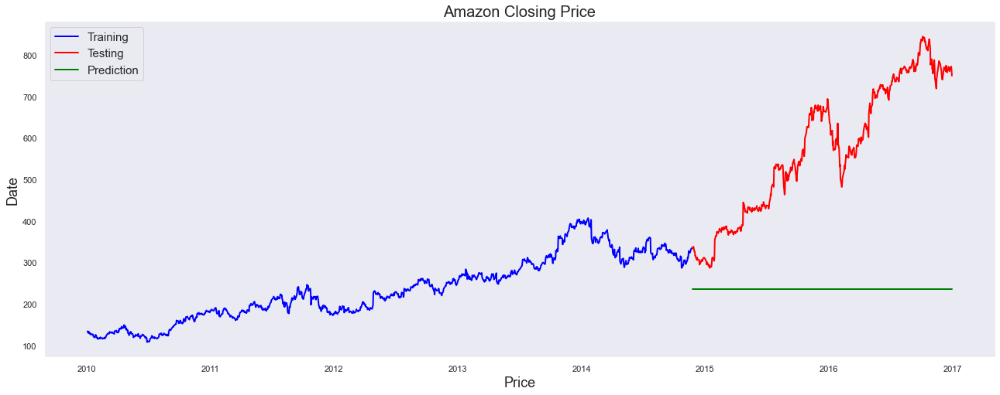

Root mean Square =  374.86808280473616


In [100]:
plt.plot(training_data, label = "Training", c = 'blue')
plt.plot(y_test,label = "Testing", c = 'red' )
plt.plot(y_pred,label = "Prediction", c = 'green')
plt.title("Amazon Closing Price", fontsize = 20)
plt.xlabel('Price', fontsize = 18)
plt.ylabel('Date', fontsize = 18)
plt.legend(loc ='best', fontsize = 15)
plt.show()
print('Root mean Square = ', np.sqrt(mse(y_test,y_pred)))

### INSIGHT
**The average of the previous observation method fails to give a better result. The predicted line is far from the test line and it yields a very big root mean square.**

### LSTM Recurrent Neural Networks

In [101]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM
from sklearn.metrics import mean_squared_error as mse
from sklearn.preprocessing import MinMaxScaler

### FEATURE ENGINEERING

In [102]:
#scaling of data
scale = MinMaxScaler()
scale_data=scale.fit_transform(df1)
scale_data

array([[0.03437308],
       [0.03544683],
       [0.03213048],
       ...,
       [0.90182809],
       [0.8923412 ],
       [0.87157324]])

In [103]:
training_len = math.ceil(len(scale_data) * .7)
training_len

1234

In [104]:
# creating a training  and testing data
train = scale_data[0:training_len, :]
train.shape

(1234, 1)

In [105]:
#spliting to X anf y train
## The Time shift = 60
# creating a training  and testing data

train = scale_data[0:training_len, :]
X_train = []
y_train =[]
for i in range(60,len(train)):
    X_train.append(train[i-60:i,0])
    y_train.append(train[i,0])

In [106]:
len(X_train),len(y_train)

(1174, 1174)

### Reshaping the X_train for Neural Network purpose

In [107]:
X_train = np.array(X_train)
y_train = np.array(y_train)
X_train= X_train.reshape(X_train.shape[0], X_train.shape[1], 1)
X_train.shape,y_train.shape

((1174, 60, 1), (1174,))

### LSTM MODEL

In [108]:
model = Sequential()
    
model.add(LSTM(50, input_shape=(X_train.shape[1], 1), return_sequences=True))
model.add(LSTM(50, return_sequences=False))
model.add(Dense(25))
model.add(Dense(1))
    

model.compile(optimizer = 'adam', loss = 'mean_squared_error')
model.fit(X_train,y_train, batch_size = 1,epochs =1)

1174/1174 [==============================] - 37s 24ms/step - loss: 6.1999e-04


In [109]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 60, 50)            10400     
                                                                 
 lstm_1 (LSTM)               (None, 50)                20200     
                                                                 
 dense (Dense)               (None, 25)                1275      
                                                                 
 dense_1 (Dense)             (None, 1)                 26        
                                                                 
Total params: 31,901
Trainable params: 31,901
Non-trainable params: 0
_________________________________________________________________


In [110]:
Model: "sequential"

### PREDICTION

In [111]:
#Testing dataset
#The Time shift = 60
test_data = scale_data[training_len-60:,:]

X_test = []
y_test=df1[training_len:,:] # the real data
for i in range(60,len(test_data)):
    X_test.append(test_data[i-60:i,0])

X_test = np.array(X_test)
y_test = np.array(y_test)
X_test=  np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))
X_test.shape,y_test.shape

((528, 60, 1), (528, 1))

In [112]:
y_pred = model.predict(X_test)

17/17 [==============================] - 2s 22ms/step


In [113]:
# Converting predictions from scaled values to original values
predictions = scale.inverse_transform(y_pred)

In [114]:
print('Root Mean Square = ' , np.sqrt(mse(y_test,predictions)))

Root Mean Square =  20.86137837861403


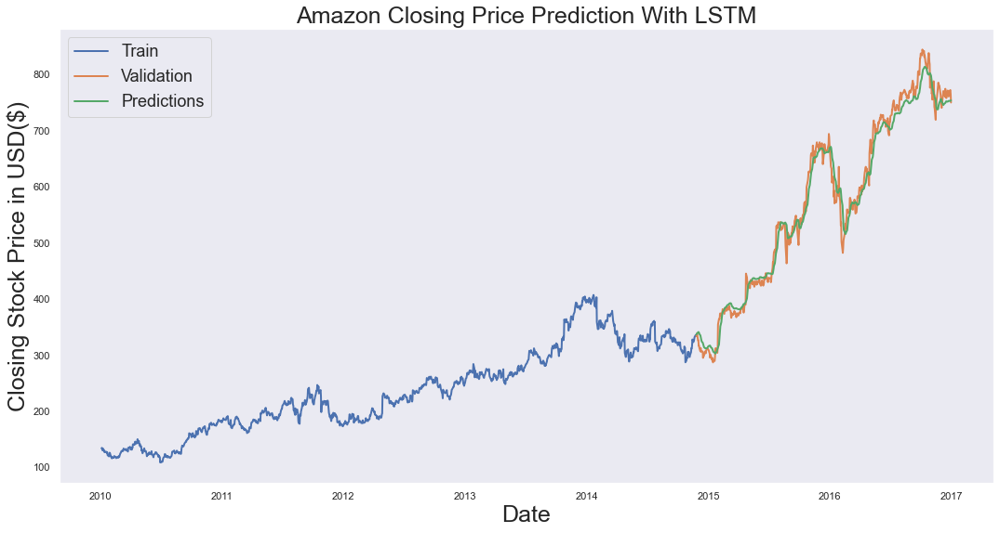

In [115]:
# ploting the model
train = df[:training_len]
valid = df[training_len:]
valid['prediction'] = predictions
plt.figure(figsize = (18,9))
plt.plot(train['close'])
plt.plot(valid[['close', 'prediction']])
plt.xlabel('Date',fontsize = 25)
plt.ylabel('Closing Stock Price in USD($)',fontsize = 25)
plt.legend(['Train', 'Validation', 'Predictions'], fontsize = 18)
plt.title("Amazon Closing Price Prediction With LSTM", fontsize = 25)
plt.show()

**NOTE: LSTM NEURAL NETWORK tends to work well with the data than the previous method. The predicted line fit the test data line**

In [116]:
print("Actual values and Predictions")
valid.head(8)

Actual values and Predictions


,close,prediction
date,,
2014-11-26,333.570007,336.706085
2014-11-28,338.640015,338.570282
2014-12-01,326.000000,340.417877
2014-12-02,326.309998,341.024506
2014-12-03,316.500000,340.888123
2014-12-04,316.929993,339.496826
2014-12-05,312.630005,337.536774
2014-12-08,306.640015,335.052856


### One day ahead prediction

In [117]:
df = apple.filter(['close'])
# the last 60 days
df1 = df[-60:].values

# scaling it
df_scale = scale.fit_transform(df1)

# positioning it into testing data
x_test = []

x_test.append(df_scale)
# to array and reshaping
x_test = np.array(x_test)
x_test = x_test.reshape(x_test.shape[0], x_test.shape[1], 1)
# prediction
pred = model.predict(x_test)
pred_price = scale.inverse_transform(pred)
pred_price

1/1 [==============================] - 0s 120ms/step


array([[116.4019]], dtype=float32)

### APPLE

In [118]:
#create a new dataset with the close column
apple_close = apple.filter(['close'])
cl_apple = apple.filter(['close']).values
cl_apple

array([[ 30.57285686],
       [ 30.62571329],
       [ 30.13857071],
       ...,
       [116.760002  ],
       [116.730003  ],
       [115.82      ]])

### FEATURE ENGINEERING

In [119]:
scale = MinMaxScaler()
scale_data=scale.fit_transform(cl_apple)
training_len = math.ceil(len(scale_data) * .8)
training_len

1410

In [120]:
# creating a training  and testing data
train = scale_data[0:training_len, :]

train.shape

(1410, 1)

In [121]:
#spliting to X anf y train
## The Time shift = 60

train = scale_data[0:training_len, :]
X_train = []
y_train =[]
for i in range(60,len(train)):
    X_train.append(train[i-60:i,0])
    y_train.append(train[i,0])

In [122]:
X_train = np.array(X_train)
y_train = np.array(y_train)
X_train= X_train.reshape(X_train.shape[0], X_train.shape[1], 1)
X_train.shape,y_train.shape

((1350, 60, 1), (1350,))

### MODEL

In [123]:
model = Sequential()
    
model.add(LSTM(50, input_shape=(X_train.shape[1], 1), return_sequences=True))
model.add(LSTM(50, return_sequences=False))
model.add(Dense(25))
model.add(Dense(1))
    

model.compile(optimizer = 'adam', loss = 'mean_squared_error')
model.fit(X_train,y_train, batch_size = 1,epochs =1)

1350/1350 [==============================] - 37s 25ms/step - loss: 0.0028


In [124]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_2 (LSTM)               (None, 60, 50)            10400     
                                                                 
 lstm_3 (LSTM)               (None, 50)                20200     
                                                                 
 dense_2 (Dense)             (None, 25)                1275      
                                                                 
 dense_3 (Dense)             (None, 1)                 26        
                                                                 
Total params: 31,901
Trainable params: 31,901
Non-trainable params: 0
_________________________________________________________________


### PREDICTION

In [125]:
#Testing dataset
#The Time shift = 60
test_data = scale_data[training_len-60:,:]

X_test = []
y_test=cl_apple[training_len:,:] # the real data
for i in range(60,len(test_data)):
    X_test.append(test_data[i-60:i,0])

X_test = np.array(X_test)
y_test = np.array(y_test)
X_test=  np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))
X_test.shape,y_test.shape

((352, 60, 1), (352, 1))

In [126]:
# Converting predictions from scaled values to original values
apple_pred = model.predict(X_test)
predictions = scale.inverse_transform(apple_pred)

11/11 [==============================] - 1s 22ms/step


In [127]:
print('Root Mean Square = ' , np.sqrt(mse(y_test,predictions)))

Root Mean Square =  4.593933329827909


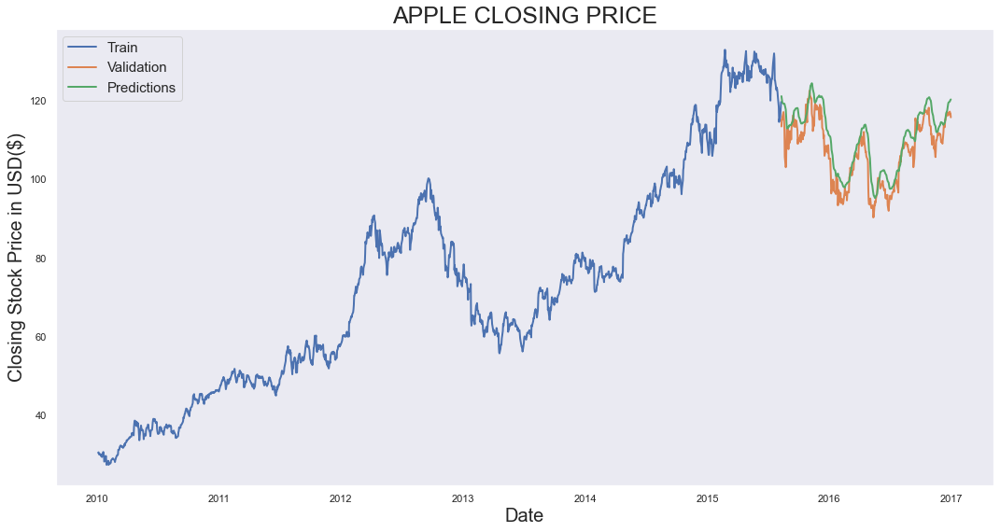

In [128]:
# ploting the model
train = apple_close[:training_len]
valid = apple_close[training_len:]
valid['prediction'] = predictions
plt.figure(figsize = (18,9))
plt.plot(train['close'])
plt.plot(valid[['close', 'prediction']])
plt.xlabel('Date',fontsize = 20)
plt.ylabel('Closing Stock Price in USD($)', fontsize = 20)
plt.legend(['Train', 'Validation', 'Predictions'], fontsize = 15)
plt.title('APPLE CLOSING PRICE', fontsize = 25)
plt.show()

In [129]:
print('Actual values and Predicted values')
valid.head(10)

Actual values and Predicted values


,close,prediction
date,,
2015-08-11,113.489998,121.189285
2015-08-12,115.239998,120.498886
2015-08-13,115.150002,119.954445
2015-08-14,115.959999,119.518036
2015-08-17,117.160004,119.265862
2015-08-18,116.500000,119.255653
2015-08-19,115.010002,119.311523
2015-08-20,112.650002,119.260384
2015-08-21,105.760002,118.932732


### Prediction

In [130]:
# prediction
df = apple.filter(['close'])
# the last 60 days
df1 = df[-60:].values

# scaling it
df_scale = scale.fit_transform(df1)

# positioning it into testing data
x_test = []

x_test.append(df_scale)
# to array and reshaping
x_test = np.array(x_test)
x_test = x_test.reshape(x_test.shape[0], x_test.shape[1], 1)
# prediction
pred = model.predict(x_test)
pred_price = scale.inverse_transform(pred)
print('The following day prediction')
pred_price

1/1 [==============================] - 1s 1s/step
The following day prediction


array([[117.18527]], dtype=float32)

### MICROSOFT

In [131]:
#create a new dataset with the close column
microsoft_close = microsoft.filter(['close'])
cl_microsoft = microsoft.filter(['close']).values
cl_microsoft

array([[30.950001],
       [30.959999],
       [30.77    ],
       ...,
       [62.990002],
       [62.900002],
       [62.139999]])

### FEATURE ENGINEERING

In [132]:
scale = MinMaxScaler()
scale_data=scale.fit_transform(cl_microsoft)
training_len = math.ceil(len(scale_data) * .7)
training_len
# creating a training  and testing data
train = scale_data[0:training_len, :]

train.shape


(1234, 1)

In [133]:
#spliting to X anf y train
## The Time shift = 60

train = scale_data[0:training_len, :]
X_train = []
y_train =[]
for i in range(60,len(train)):
    X_train.append(train[i-60:i,0])
    y_train.append(train[i,0])
X_train = np.array(X_train)
y_train = np.array(y_train)
X_train= X_train.reshape(X_train.shape[0], X_train.shape[1], 1)
X_train.shape,y_train.shape

((1174, 60, 1), (1174,))

### Model

In [134]:
model = Sequential()
    
model.add(LSTM(50, input_shape=(X_train.shape[1], 1), return_sequences=True))
model.add(LSTM(50, return_sequences=False))
model.add(Dense(25))
model.add(Dense(1))
    

model.compile(optimizer = 'adam', loss = 'mean_squared_error')
model.fit(X_train,y_train, batch_size = 1,epochs =5)

Epoch 1/5
1174/1174 [==============================] - 36s 27ms/step - loss: 0.0012
Epoch 2/5
1174/1174 [==============================] - 29s 25ms/step - loss: 5.9475e-04
Epoch 3/5
1174/1174 [==============================] - 31s 27ms/step - loss: 3.9760e-04
Epoch 4/5
1174/1174 [==============================] - 30s 26ms/step - loss: 3.0171e-04
Epoch 5/5
1174/1174 [==============================] - 32s 27ms/step - loss: 2.7322e-04


### Prediction

In [135]:
#Testing dataset
#The Time shift = 60
test_data = scale_data[training_len-60:,:]

X_test = []
y_test=cl_microsoft[training_len:,:] # the real data
for i in range(60,len(test_data)):
    X_test.append(test_data[i-60:i,0])

X_test = np.array(X_test)
y_test = np.array(y_test)
X_test=  np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))
X_test.shape,y_test.shape

((528, 60, 1), (528, 1))

In [136]:
# Converting predictions from scaled values to original values
pred = model.predict(X_test)
predictions = scale.inverse_transform(pred)

17/17 [==============================] - 2s 22ms/step


In [137]:
print('Root Mean Square = ' , np.sqrt(mse(y_test,predictions)))

Root Mean Square =  0.8768759426033106


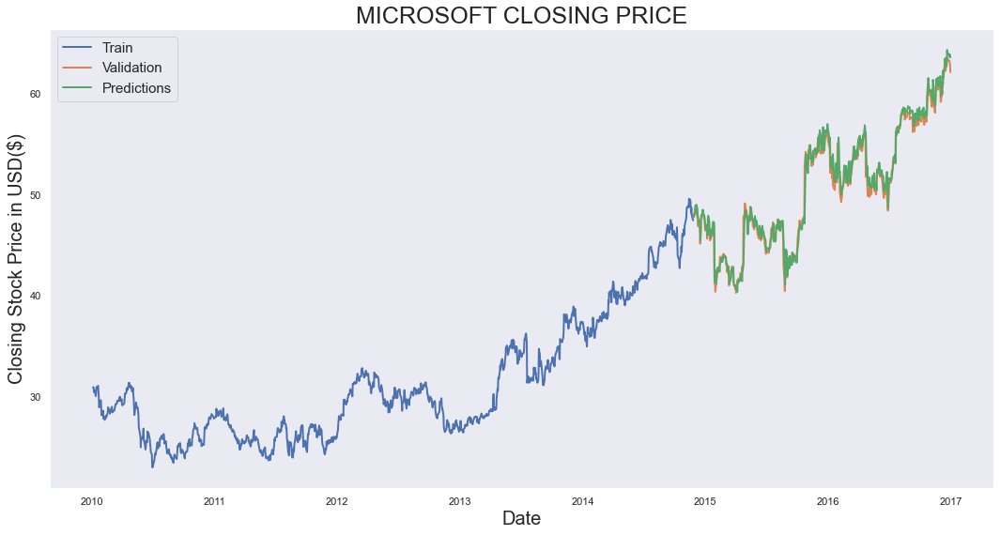

In [138]:
# ploting the model
train = microsoft_close[:training_len]
valid = microsoft_close[training_len:]
valid['prediction'] = predictions
plt.figure(figsize = (18,9))
plt.plot(train['close'])
plt.plot(valid[['close', 'prediction']])
plt.xlabel('Date',fontsize = 20)
plt.ylabel('Closing Stock Price in USD($)', fontsize = 20)
plt.legend(['Train', 'Validation', 'Predictions'], fontsize = 15)
plt.title('MICROSOFT CLOSING PRICE',fontsize = 25)
plt.show()

In [139]:
print('Actual and Predicted values')
valid.head(10)

Actual and Predicted values


,close,prediction
date,,
2014-11-26,47.750000,47.782909
2014-11-28,47.810001,48.105877
2014-12-01,48.619999,48.154163
2014-12-02,48.459999,48.937241
2014-12-03,48.080002,48.691200
2014-12-04,48.840000,48.245617
2014-12-05,48.419998,49.026699
2014-12-08,47.700001,48.575935
2014-12-09,47.590000,47.841328


### One day ahead prediction

In [140]:
df = microsoft.filter(['close'])
# the last 60 days
df1 = df[-60:].values

# scaling it
df_scale = scale.fit_transform(df1)

# positioning it into testing data
x_test = []

x_test.append(df_scale)
# to array and reshaping
x_test = np.array(x_test)
x_test = x_test.reshape(x_test.shape[0], x_test.shape[1], 1)
# prediction
pred = model.predict(x_test)
pred_price = scale.inverse_transform(pred)
pred_price

1/1 [==============================] - 0s 64ms/step


array([[62.149757]], dtype=float32)

### LSTM was adopted because it gives a better result than all other models